In [1]:
import os
import sys
LIB_PATH = os.path.dirname(os.getcwd())
sys.path.append(LIB_PATH)

import matplotlib.pyplot as plt
%matplotlib inline

from src import data

In [2]:
DIRECTORY_DATA = os.path.join(LIB_PATH, 'data')
DIRECTORY_OUTPUT = os.path.join(LIB_PATH, 'output')

# Load Images

In [3]:
image_pairs = data.ImagePairs(DIRECTORY_DATA)
image_pairs.load_images()

# Baseline

In [ ]:
OUTPUT_DIRECTORY = os.path.join(DIRECTORY_OUTPUT, 'baseline')

# Detect Features and Plot
image_pairs.detect_features_and_annotate()
image_pairs.show_annotations(output_directory=OUTPUT_DIRECTORY)

# Match Feature Points and Visualize
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

matcher = data.MatcherFlannBased(index_params, search_params, 2)
image_pairs.match_descriptors_and_annotate(matcher)
image_pairs.show_matching_annotations(output_directory=OUTPUT_DIRECTORY)

# Homograph (Ransac)
homographer = data.HomographerRansac(
    minimum_match_count=10,
    reprojection_threshold=3
)
image_pairs.find_homography(homographer)
image_pairs.show_homography(output_directory=OUTPUT_DIRECTORY)

# Stitching
image_pairs.stitch()
image_pairs.show_stitched(output_directory=OUTPUT_DIRECTORY)

# Homograph (LMeDS)

In [ ]:
OUTPUT_DIRECTORY = os.path.join(DIRECTORY_OUTPUT, 'lmeds')

# Detect Features and Plot
image_pairs.detect_features_and_annotate()
image_pairs.show_annotations(output_directory=OUTPUT_DIRECTORY)

# Match Feature Points and Visualize
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

matcher = data.MatcherFlannBased(index_params, search_params, 2)
image_pairs.match_descriptors_and_annotate(matcher)
image_pairs.show_matching_annotations(output_directory=OUTPUT_DIRECTORY)

# Homograph (Ransac)
homographer = data.HomographerLMeDS(
    minimum_match_count=10
)
image_pairs.find_homography(homographer)
image_pairs.show_homography(output_directory=OUTPUT_DIRECTORY)

# Stitching
image_pairs.stitch()
image_pairs.show_stitched(output_directory=OUTPUT_DIRECTORY)

# BFMatcher | LMEDS

In [ ]:
distance_measure = ['norm_l2',  'norm_l1', 'norm_l2sqr']
for dist in distance_measure:
    OUTPUT_DIRECTORY = os.path.join(DIRECTORY_OUTPUT, dist)
    # Detect Features and Plot
    image_pairs.detect_features_and_annotate()
    image_pairs.show_annotations(output_directory=OUTPUT_DIRECTORY)

    # Match Feature Points and Visualize
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)

    matcher = data.MatcherBruteForce(norm_type = dist, cross_check=False, k=2)
    image_pairs.match_descriptors_and_annotate(matcher)
    image_pairs.show_matching_annotations(output_directory=OUTPUT_DIRECTORY)

    # Homograph (Ransac)
    homographer = data.HomographerLMeDS(
        minimum_match_count=10
    )
    image_pairs.find_homography(homographer)
    image_pairs.show_homography(output_directory=OUTPUT_DIRECTORY)

    # Stitching
    image_pairs.stitch()
    image_pairs.show_stitched(output_directory=OUTPUT_DIRECTORY)

# BFMatcher | RANSAC

D:\Users\Admin\Dropbox\Yuan Qing\NTU MSAI\AI6121\project\src\data.py:266: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 1, figsize=(16,8))


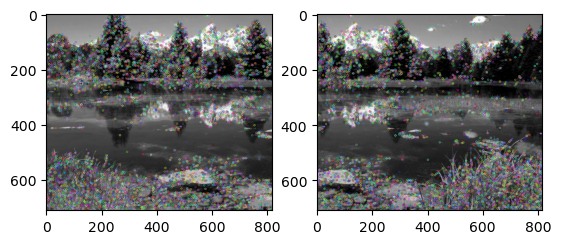

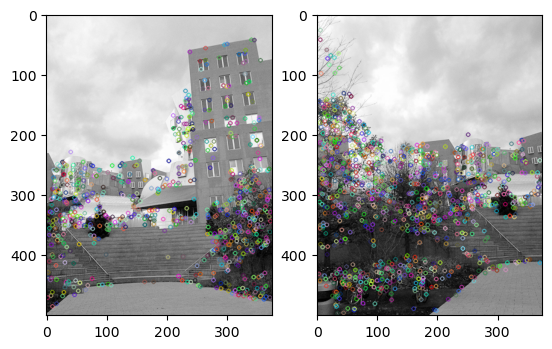

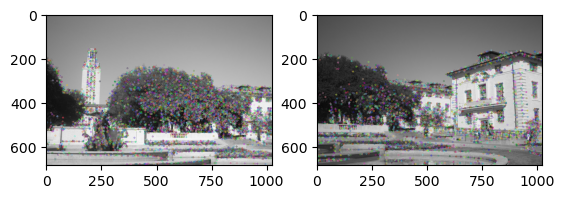

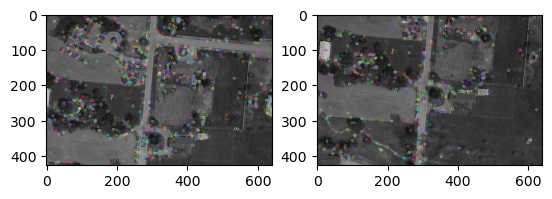

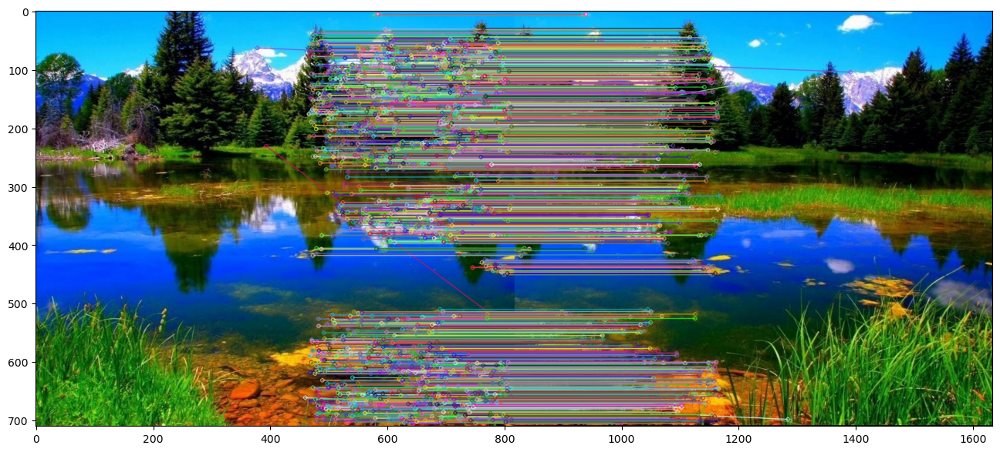

...

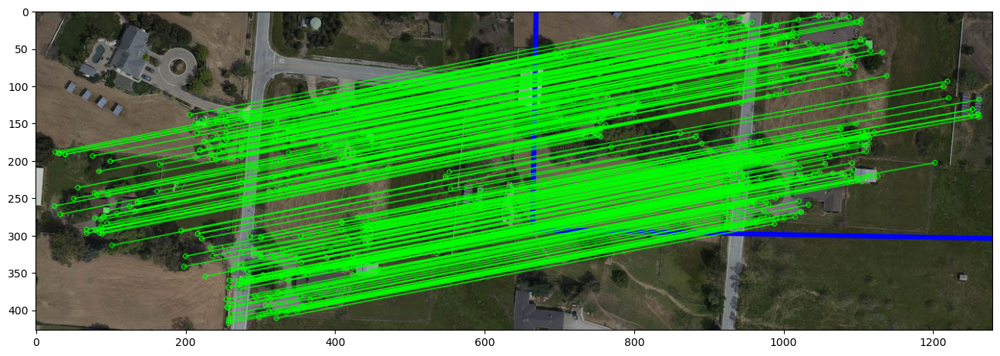

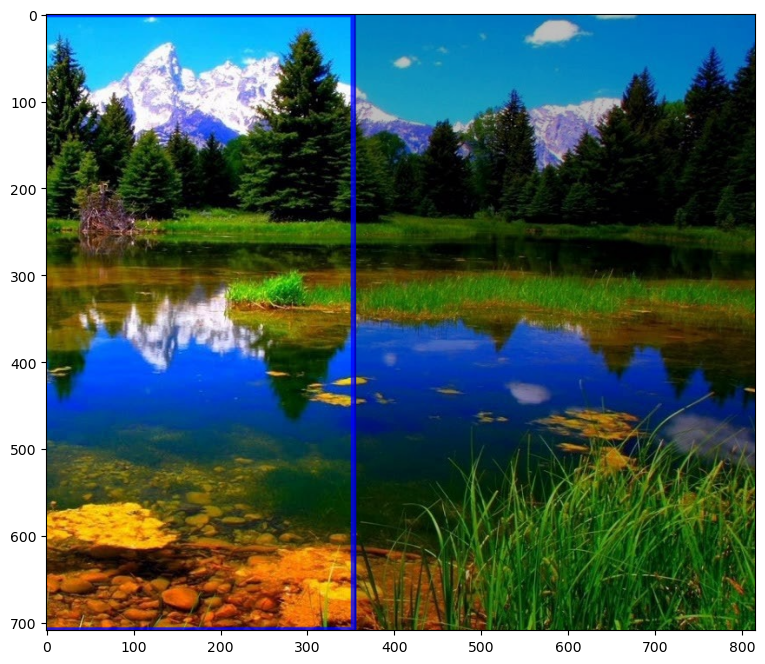

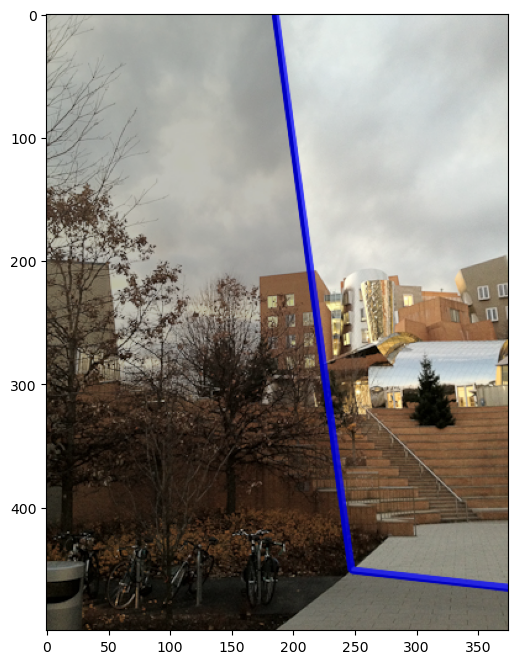

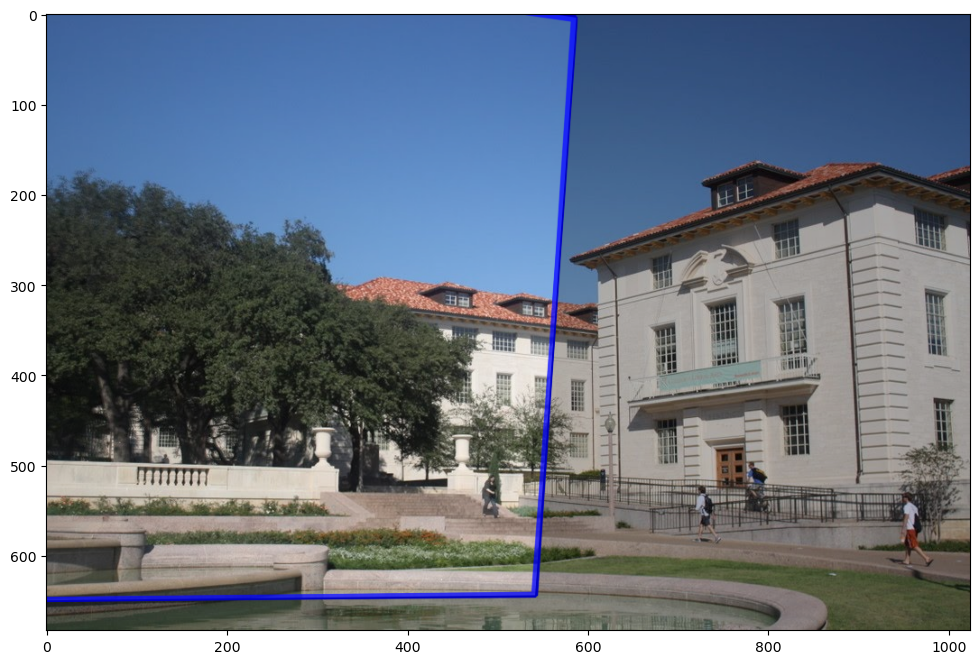

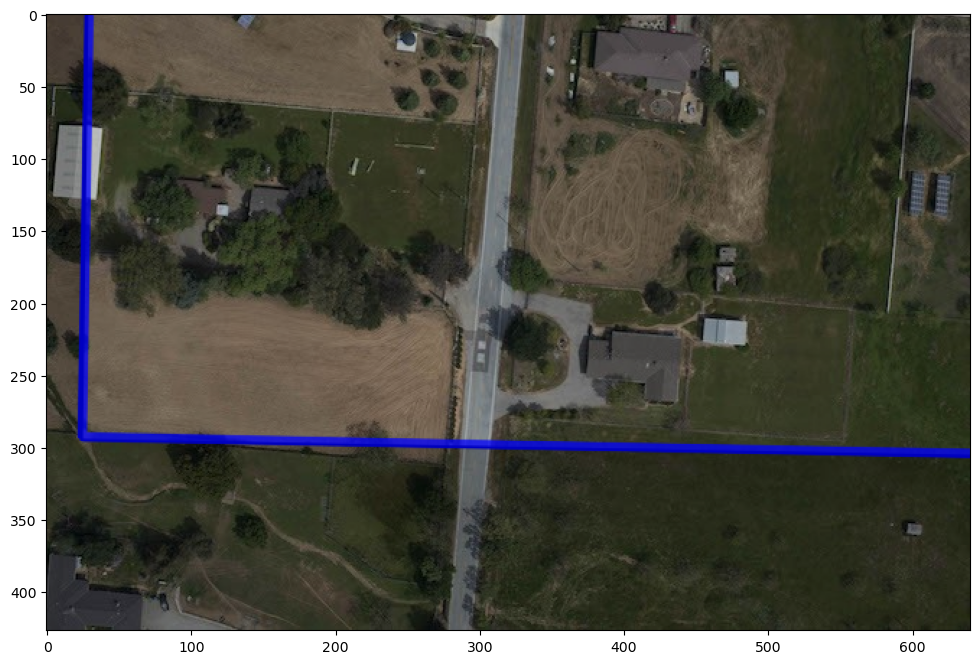

In [4]:
distance_measure = ['norm_l2',  'norm_l1', 'norm_l2sqr']
for dist in distance_measure:
    OUTPUT_DIRECTORY = os.path.join(DIRECTORY_OUTPUT, dist)

    # Detect Features and Plot
    image_pairs.detect_features_and_annotate()
    image_pairs.show_annotations(output_directory=OUTPUT_DIRECTORY)

    # Match Feature Points and Visualize
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)

    matcher = data.MatcherBruteForce(norm_type = dist, cross_check=False, k=2)
    image_pairs.match_descriptors_and_annotate(matcher)
    image_pairs.show_matching_annotations(output_directory=OUTPUT_DIRECTORY)

    # Homograph (Ransac)
    homographer = data.HomographerRansac(
        minimum_match_count=10,
        reprojection_threshold=3
    )
    image_pairs.find_homography(homographer)
    image_pairs.show_homography(output_directory=OUTPUT_DIRECTORY)

    # Stitching
    image_pairs.stitch()
    image_pairs.show_stitched(output_directory=OUTPUT_DIRECTORY)